# Import Packages

In [73]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns

/Users/tanish/anaconda3/envs/QiskitEnv/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# Getting Data

In [30]:
etf_data = pd.read_csv("normalized_etf_monthly.csv").drop('Unnamed: 0', axis = 1)
etf_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Year        1460 non-null   int64  
 1   Month       1460 non-null   int64  
 2   ETF         1460 non-null   object 
 3   Price       1460 non-null   float64
 4   Volatility  1460 non-null   float64
dtypes: float64(2), int64(2), object(1)
memory usage: 57.2+ KB


In [40]:
etfs = etf_data['ETF'].unique()

transformed_etf_data = pd.DataFrame() 

for etf in etfs: 
    tempData = etf_data[etf_data['ETF'] == etf].reset_index()
    transformed_etf_data['Year'] = tempData['Year']
    transformed_etf_data['Month'] = tempData['Month']
    transformed_etf_data[etf + '_Price'] = tempData['Price']
    transformed_etf_data[etf + '_Volatility'] = tempData['Volatility']
    transformed_etf_data = transformed_etf_data.reset_index(drop=True)

In [41]:
transformed_etf_data

,Year,Month,Agri_Machinery_ETF_Price,Agri_Machinery_ETF_Volatility,Food_Beverage_ETF_Price,Food_Beverage_ETF_Volatility,Investment_Funds_ETF_Price,Investment_Funds_ETF_Volatility,Restaurant_FastFood_ETF_Price,Restaurant_FastFood_ETF_Volatility,Retail_ETF_Price,Retail_ETF_Volatility
0,1999,11,36.835142,18.702643,40.019708,16.961994,125.522357,22.170051,34.920701,12.464929,17.868213,0.0
1,1999,12,34.957983,17.379747,37.129539,15.700905,129.629927,21.397963,32.392583,11.780527,14.447012,0.0
2,2000,1,37.142867,18.329527,35.526435,14.800639,129.359423,20.731690,30.139771,9.594676,15.766343,0.0
3,2000,2,31.221460,14.267052,32.619976,14.833653,123.136288,24.351636,28.223431,8.796923,16.672860,0.0
4,2000,3,29.319403,13.248931,31.920499,16.434221,127.442178,27.730370,29.358011,9.440700,18.823416,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
287,2023,10,253.592562,124.438942,316.868611,195.721885,329.718627,169.790034,1142.686074,610.321548,198.630677,0.0
288,2023,11,249.251962,121.746948,342.498279,214.060211,345.688258,176.976723,1314.577751,705.197133,199.673985,0.0
289,2023,12,264.998565,126.792201,407.599971,264.730916,366.626038,186.600980,1415.650851,757.003628,214.157736,0.0
290,2024,1,273.865412,131.849517,425.311863,276.258099,376.130457,190.784902,1438.604583,764.559535,224.549750,0.0


In [44]:
state_population_data = pd.read_csv("state_population_data.csv")
state_population_data.head(5)

,STATE,POPESTIMATE2000,POPESTIMATE2001,POPESTIMATE2002,POPESTIMATE2003,POPESTIMATE2004,POPESTIMATE2005,POPESTIMATE2006,POPESTIMATE2007,POPESTIMATE2008,...,POPESTIMATE2011,POPESTIMATE2012,POPESTIMATE2013,POPESTIMATE2014,POPESTIMATE2015,POPESTIMATE2016,POPESTIMATE2017,POPESTIMATE2018,POPESTIMATE2019,POPESTIMATE2020
0,0,282162411,284968955,287625193,290107933,292805298,295516599,298379912,301231207,304093966,...,311583481,313877662,316059947,318386329,320738994,323071755,325122128,326838199,328329953,329484123
1,0,282162411,284968955,287625193,290107933,292805298,295516599,298379912,301231207,304093966,...,55608318,55782661,55912775,56021339,56052790,56063777,56083383,56084543,56002934,55849869
2,0,282162411,284968955,287625193,290107933,292805298,295516599,298379912,301231207,304093966,...,67164092,67348275,67576524,67765576,67885682,68018175,68160342,68263019,68340091,68316744
3,0,282162411,284968955,287625193,290107933,292805298,295516599,298379912,301231207,304093966,...,116019483,117264196,118397213,119666248,121049223,122419547,123611036,124649156,125686544,126662754
4,0,282162411,284968955,287625193,290107933,292805298,295516599,298379912,301231207,304093966,...,72791588,73482530,74173435,74933166,75751299,76570256,77267367,77841481,78300384,78654756


In [64]:
snap_data = pd.read_csv("snap_data.csv")
snap_data.head()

summary_snap_data = snap_data
for column in summary_snap_data.columns:
    if 'Summary' not in column:
        summary_snap_data = summary_snap_data.drop(column, axis = 1) 

summary_snap_data['Year'] = snap_data['Year']
summary_snap_data['Month'] = snap_data['Month']

In [67]:
finalDF = pd.merge(
    left=summary_snap_data, 
    right=transformed_etf_data,
    how='left',
    left_on=['Year', 'Month'],
    right_on=['Year', 'Month'])

In [68]:
finalDF = finalDF.dropna()

In [65]:
summary_snap_data

,Summary_SNAP All Persons Public Assistance Participation,Summary_SNAP All Persons Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA People,Summary_SNAP All Households Public Assistance Participation,Summary_SNAP All Households Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA Households,Summary_SNAP All Total Actual PA & Non-PA Issuance,Year,Month
0,10033430.0,8694465.0,18727895.0,3725119.0,3432740.0,7157859.0,9.716730e+08,1989,1
1,10028846.0,8571573.0,18600419.0,3750006.0,3411273.0,7161279.0,9.530917e+08,1989,7
2,10633151.0,9165459.0,19798610.0,4005774.0,3678631.0,7684405.0,1.165783e+09,1990,1
3,11069768.0,9222609.0,20292377.0,4168557.0,3748117.0,7916674.0,1.181467e+09,1990,7
4,11758987.0,10207681.0,21966668.0,4454154.0,4163159.0,8617313.0,1.397223e+09,1991,1
...,...,...,...,...,...,...,...,...,...
65,6055037.0,35834120.0,41889157.0,4098594.0,18246095.0,22344689.0,8.386243e+09,2021,7
66,6249559.0,35086361.0,41335920.0,4189968.0,17468153.0,21658121.0,8.647230e+09,2022,1
67,6685176.0,34457181.0,41142357.0,4456880.0,17169812.0,21626692.0,9.014863e+09,2022,7
68,6421830.0,36282201.0,42704031.0,4324757.0,18199449.0,22524206.0,9.583957e+09,2023,1


# Data Visualization

In [ ]:
snapNational = finalDF

In [69]:
finalDF

,Summary_SNAP All Persons Public Assistance Participation,Summary_SNAP All Persons Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA People,Summary_SNAP All Households Public Assistance Participation,Summary_SNAP All Households Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA Households,Summary_SNAP All Total Actual PA & Non-PA Issuance,Year,Month,Agri_Machinery_ETF_Price,Agri_Machinery_ETF_Volatility,Food_Beverage_ETF_Price,Food_Beverage_ETF_Volatility,Investment_Funds_ETF_Price,Investment_Funds_ETF_Volatility,Restaurant_FastFood_ETF_Price,Restaurant_FastFood_ETF_Volatility,Retail_ETF_Price,Retail_ETF_Volatility
22,6790358.0,10086569.0,16876927.0,2972694.0,4211833.0,7184527.0,1.223131e+09,2000,1,37.142867,18.329527,35.526435,14.800639,129.359423,20.731690,30.139771,9.594676,15.766343,0.0
23,6923448.0,9970737.0,16894185.0,3076395.0,4170816.0,7247211.0,1.223648e+09,2000,7,30.381872,12.649045,33.547624,16.027062,129.957482,28.567374,29.186199,8.518114,14.420985,0.0
24,7131201.0,10158394.0,17289595.0,3172823.0,4256868.0,7429691.0,1.280612e+09,2001,1,33.760939,15.805916,38.209637,17.512640,122.230382,18.868576,33.100672,9.261870,12.277433,0.0
25,6814222.0,10717831.0,17532053.0,3070288.0,4477870.0,7548158.0,1.324812e+09,2001,7,35.808831,18.656423,39.442263,17.926690,113.328149,11.445651,29.873930,8.913858,20.323822,0.0
26,6599560.0,12306086.0,18905646.0,2974883.0,5138760.0,8113643.0,1.513291e+09,2002,1,36.308684,17.836498,42.942141,19.692925,107.427076,10.605124,34.036774,12.375332,37.061765,0.0
27,6587049.0,12691496.0,19278545.0,3031209.0,5238413.0,8269622.0,1.530643e+09,2002,7,35.104314,14.729091,41.908781,20.341799,86.717126,3.123611,24.500837,2.677727,61.202939,0.0
28,6451602.0,14504205.0,20955807.0,2983687.0,6037777.0,9021464.0,1.714953e+09,2003,1,35.555201,15.528725,45.628324,23.429254,87.025251,3.595464,22.072676,3.992951,40.266331,0.0
29,6501719.0,15518599.0,22020318.0,3052163.0,6399975.0,9452138.0,1.858042e+09,2003,7,42.074329,21.784052,45.532581,22.113362,95.969641,5.557166,25.795741,4.774985,51.766492,0.0
30,6599404.0,16850844.0,23450248.0,3124609.0,6971117.0,10095726.0,1.996372e+09,2004,1,55.729010,29.881298,46.831087,20.877017,102.896777,15.264649,26.259795,9.733167,42.075329,0.0
31,6715770.0,17632189.0,24347959.0,3219005.0,7315745.0,10534750.0,2.110605e+09,2004,7,53.529266,28.214500,42.801399,14.674046,98.274449,18.118304,28.858436,14.080494,37.749301,0.0


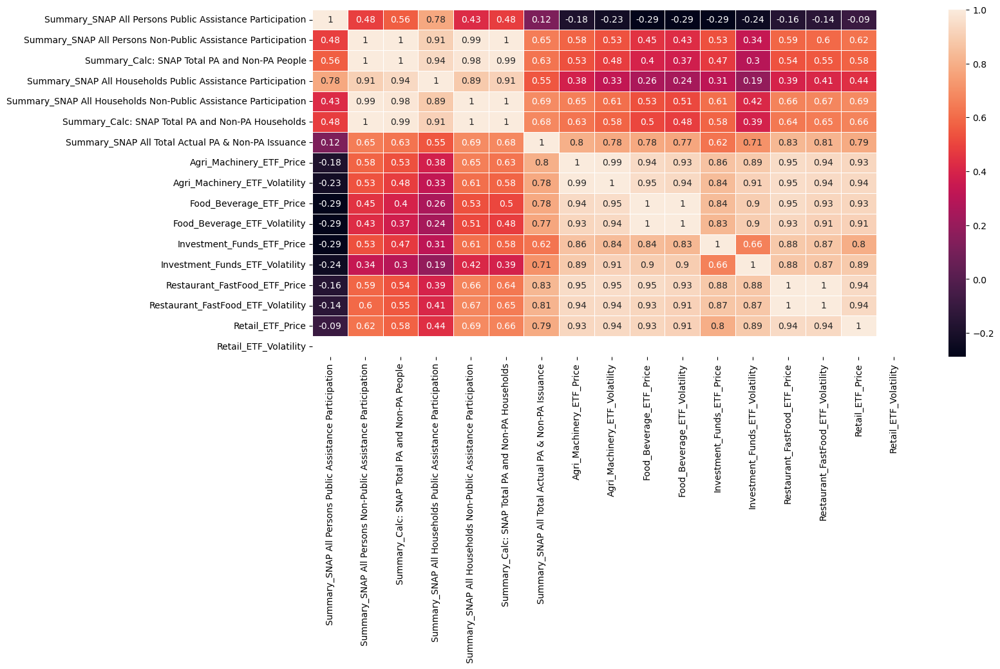

In [79]:
corr_matrix = finalDF.drop(columns=['Year', 'Month']).corr()

plt.figure(figsize=(15, 7))
sns.heatmap(corr_matrix, annot=True, cmap='rocket', linewidths=0.5)
plt.show()

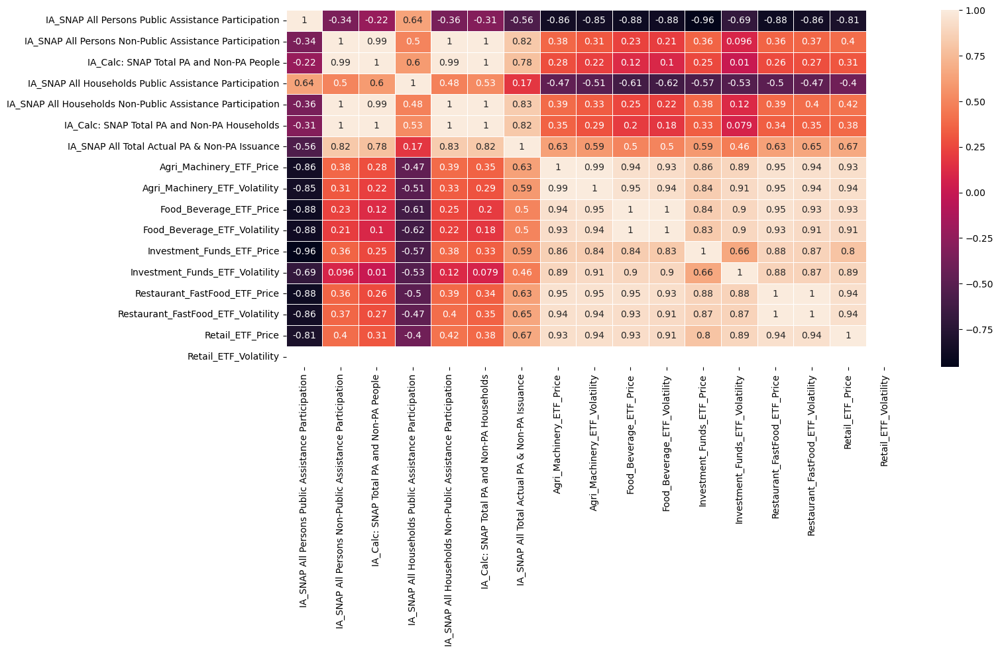

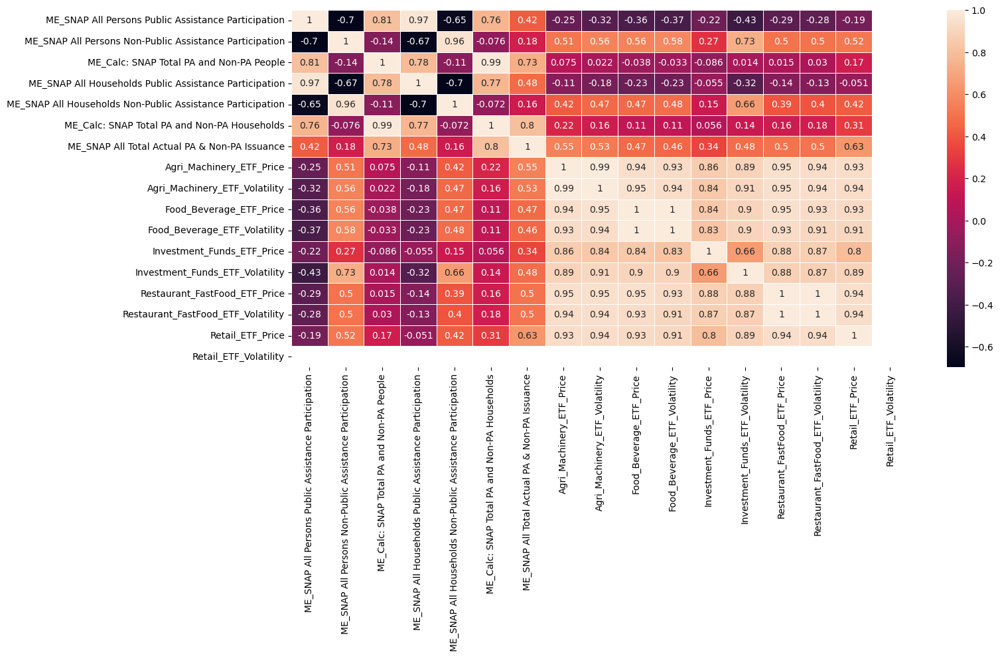

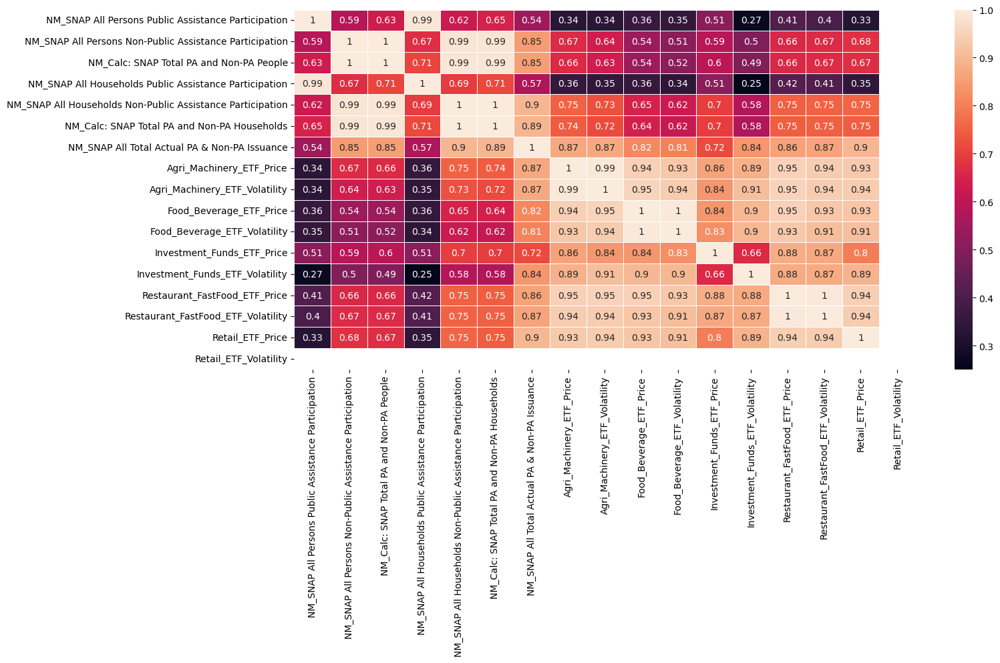

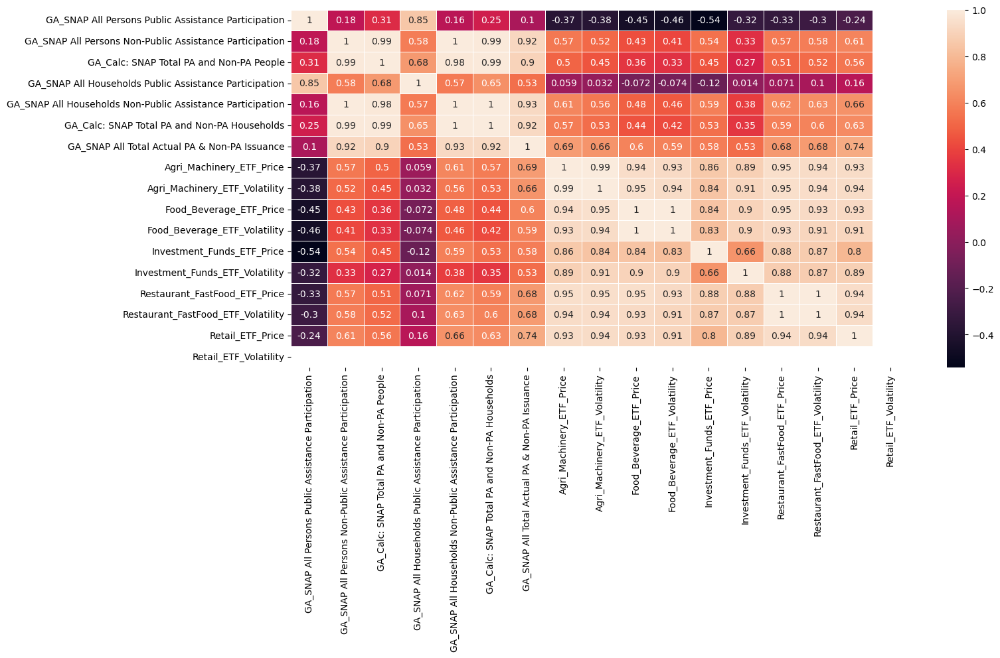

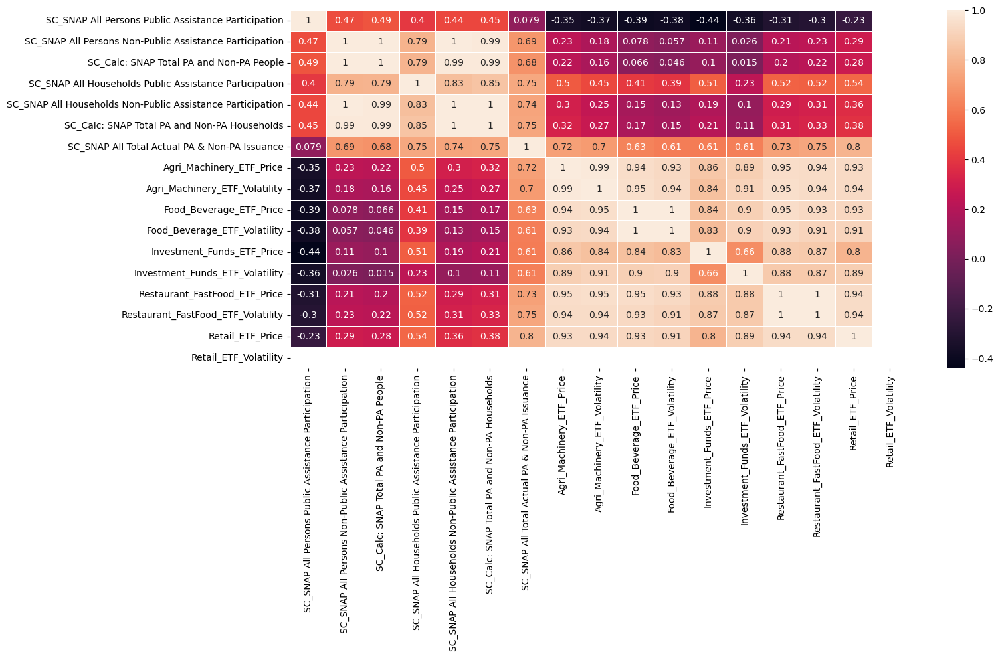

...

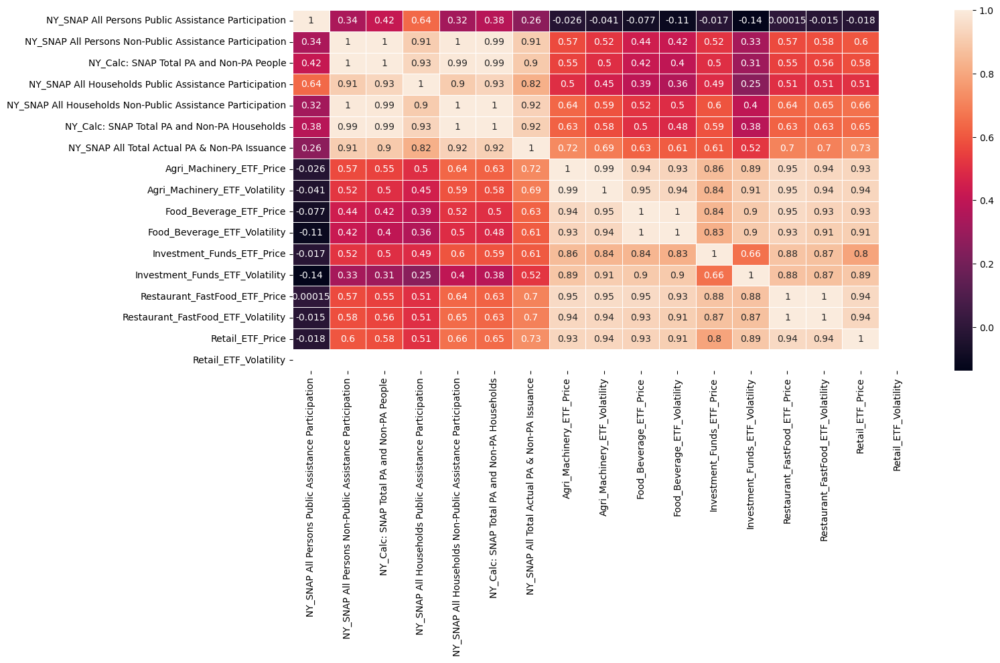

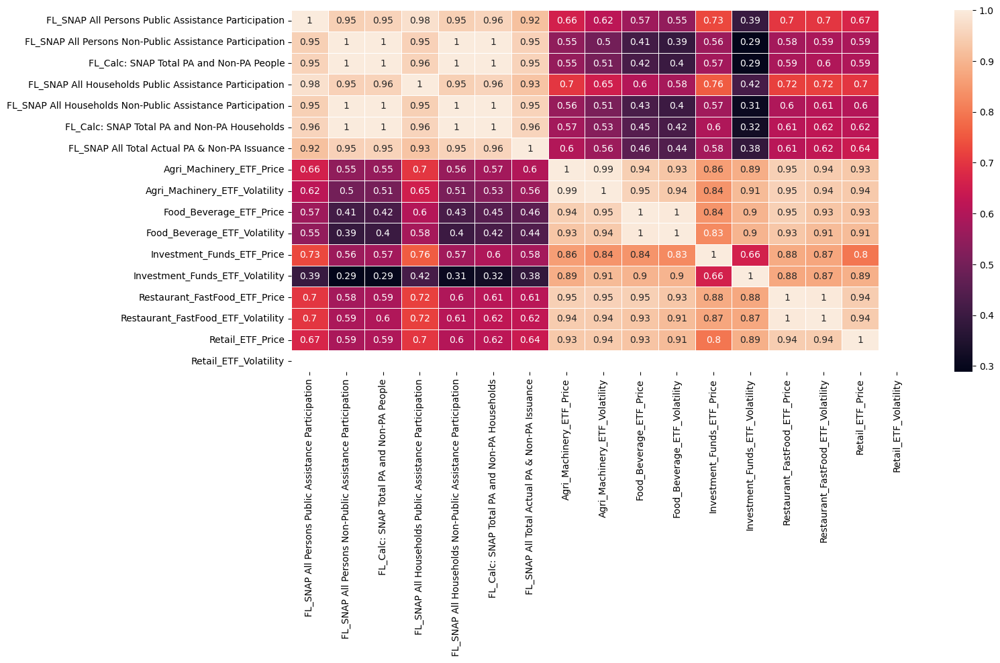

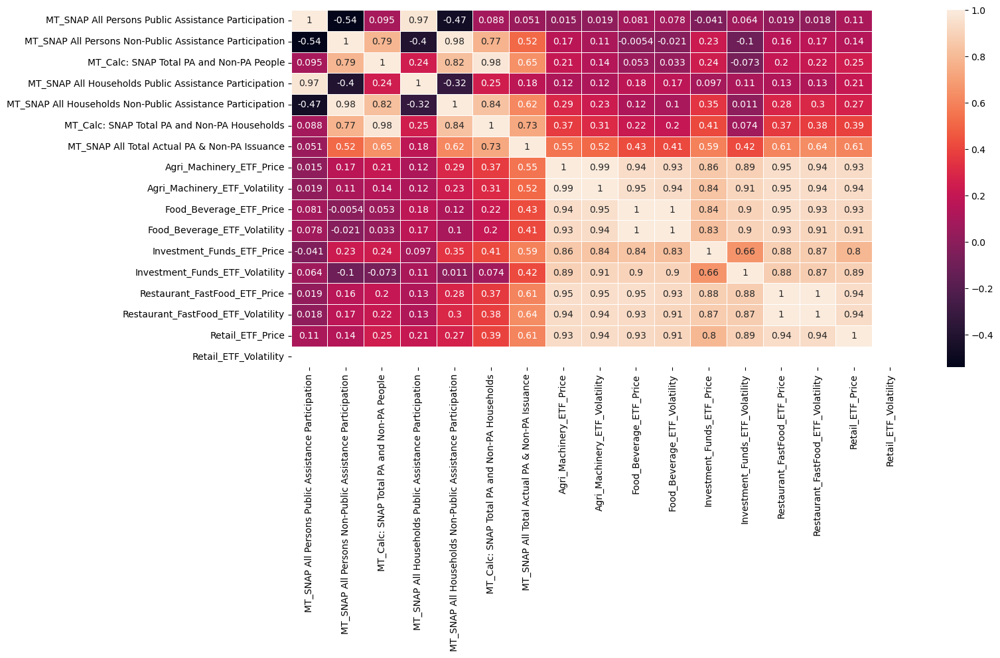

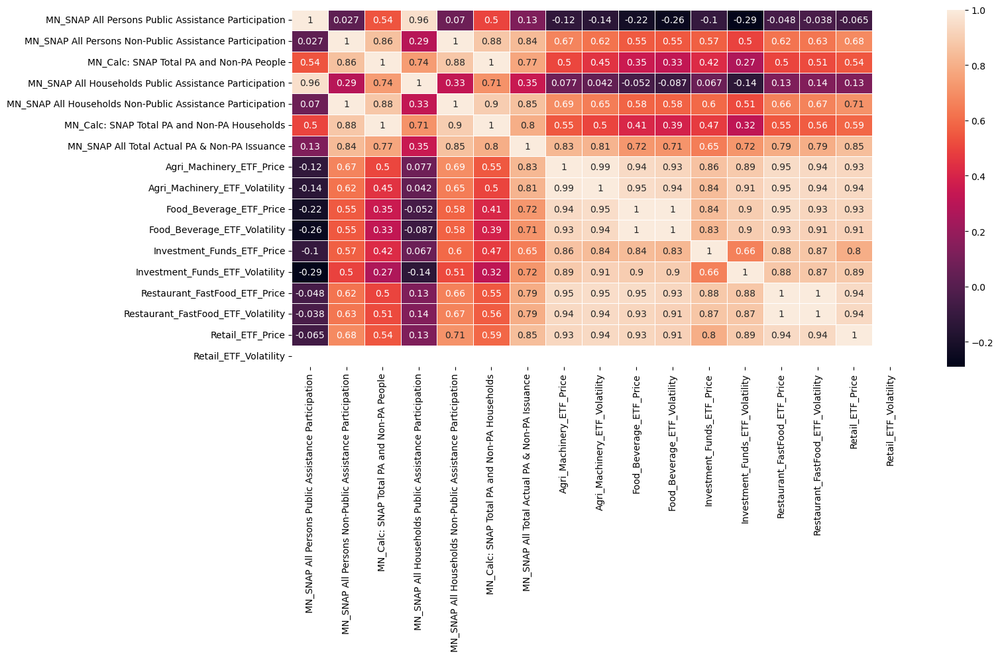

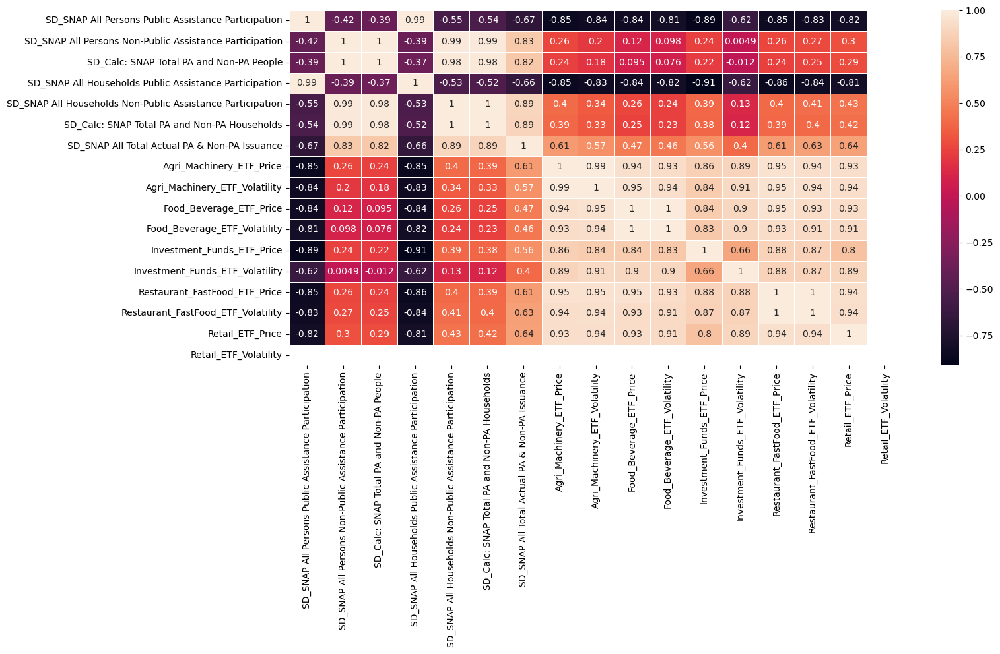

In [115]:
states = snap_data.columns[2:].str.split("_")
states = set([state[0] for state in states])

for state in states:
    state_snap_data = snap_data
    for column in state_snap_data.columns:
        if state not in column:
            state_snap_data = state_snap_data.drop(column, axis = 1) 
    
    state_snap_data['Year'] = snap_data['Year']
    state_snap_data['Month'] = snap_data['Month']
    
    finalDF2 = pd.merge(
        left=state_snap_data, 
        right=transformed_etf_data,
        how='left',
        left_on=['Year', 'Month'],
        right_on=['Year', 'Month'])
    
    finalDF2 = finalDF2.dropna()
    
    corr_matrix = finalDF2.drop(columns=['Year', 'Month']).corr()
    
    plt.figure(figsize=(15, 7))
    sns.heatmap(corr_matrix, annot=True, cmap='rocket', linewidths=0.5)
    plt.show()